# Exercise: texture

Local binary pattern (LBP) is a feature used for texture representation and classification. The LBP operator describes the surroundings of a pixel by generating a bit-code from the binary derivatives of a pixel. The operator is usually applied to greyscale images and the derivative of the intensities. Note how a pixel with a value > C is assigned ‘1’ and a pixel with a value <= C is assigned ‘0’.

In [1]:
#import modules and images
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import requests
from io import BytesIO

#generate random image from lorenpicsom
#image credit: https://picsum.photos/
url = 'https://picsum.photos/224/224'
response = requests.get(url)
img = Image.open(BytesIO(response.content))

#or you can use image of mine.
img = Image.open('assets/test_image_beach.jpg')
(h,w) = img.size
img = img.resize((h//3,w//3), Image.ANTIALIAS)

img=np.asarray(img.convert("L"))

(612, 817)

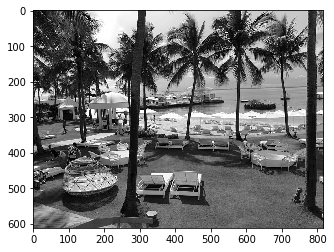

In [2]:
plt.imshow(img, cmap='gray', vmin=0, vmax=255)#'gist_gray')
img.shape

## a) LBP
Write a function that divides an input (greyscale) image into equally sized non-overlapping windows, and returns the feature descriptor for each window as distribution of LBP codes. 

#### 1. For each pixel in the window, compare the pixel to each of its 8 neighbours.  

In [3]:
def lbp(img, posX, posY):
    
    # sample matrix
    # [[0 1 2]
    #  [3 4 5]
    #  [6 7 8]]
    patch = img[posY-1:posY+2,posX-1:posX+2].astype(int)

    # subtract values by center pixel
    # [[-4 -3 -2]
    #  [-1  0  1]
    #  [ 2  3  4]]
    patch = patch - patch[1,1]
    
    # read code in circular manner
    # [-4, -3, -2, 1, 4, 3, 2, -1]
    patch = patch.ravel()
    code = np.array([patch[0],patch[1],patch[2], patch[5], patch[8], patch[7], patch[6], patch[3]])

    # clip negative to 0 and positive to 1 and reshape: 
    #[0 0 0 1 1 1 1 0]
    code = code.clip(min=0, max=1)

    #convert into int from bin
    #30
    code = code.dot(2**np.arange(code.size)[::-1])

    return code

In [4]:
lbp_image = np.zeros(img.shape, dtype=int)
for x in range(1,img.shape[1]-1):
    for y in range(1,img.shape[0]-1):
        lbp_image[y,x] = lbp(img, x, y)

In [5]:
def plot(imgs, titles=[]):
    fig, axs = plt.subplots(1, len(imgs), figsize=(20, 20))
    i=0
    for ax, theta in zip(axs, imgs):
        ax.imshow(np.clip(theta,0,255), cmap='gray')       
        if titles: ax.title.set_text(titles[i])
        i=i+1              
    plt.show()

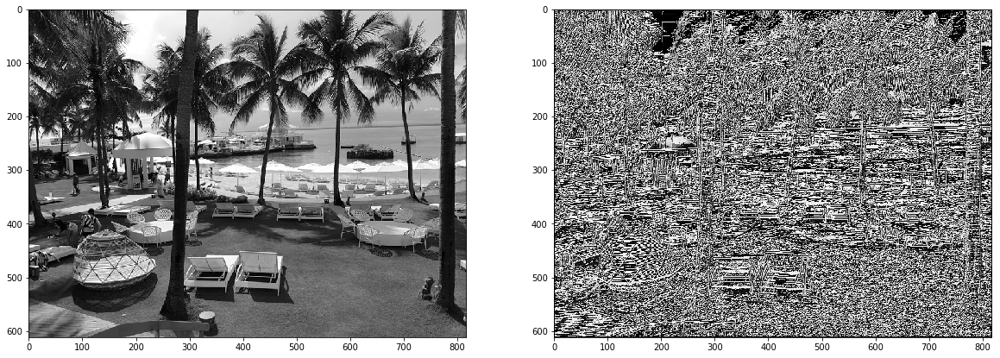

In [6]:
plot([img,lbp_image])

#### 2. Compute the histogram over the window, as the frequency of each "number" occurring. 
#### 3. Normalize the histogram.   

I use <kbd>ploty</kbd>.
You may install ploty module via
~~~terminal
#!pip install plotly
#!pip install plotly_express
~~~

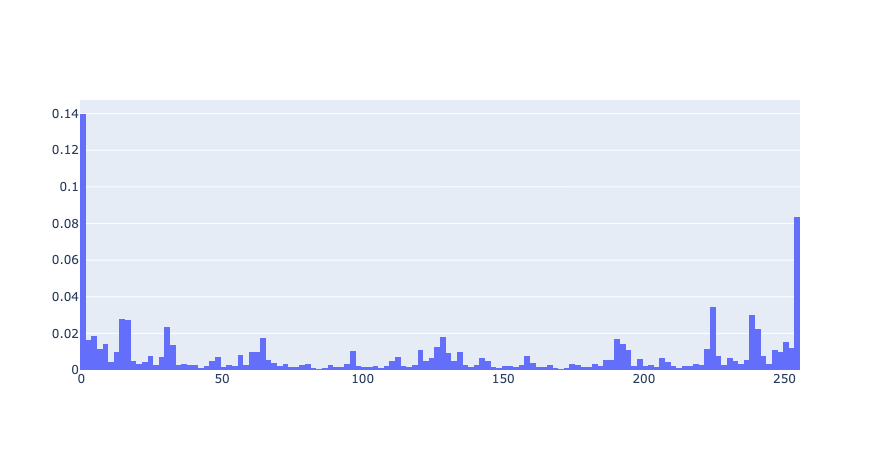

In [7]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = go.Figure(data=[go.Histogram(x=lbp_image.ravel(), histnorm='probability')])
fig.show()

#### 4. The histogram is now a feature descriptor representing the window at hand. 

## prob b)
Come up with a descriptor to represent the whole image as consisting of multiple windows.  
Hint: Think of combining several local descriptions into a global description.  

First, set the number of bins in which you want to devide the image.  
Then devide the image.

In [8]:
#Set the bin here
bins = 5

In [9]:
width_window = lbp_image.shape[1] // bins
height_window = lbp_image.shape[0] // bins
windows=[]

for j in range (0, height_window*bins, height_window):
    for i in range(0, width_window*bins, width_window):
        windows.append(lbp_image[j:j+height_window,i:i+width_window])

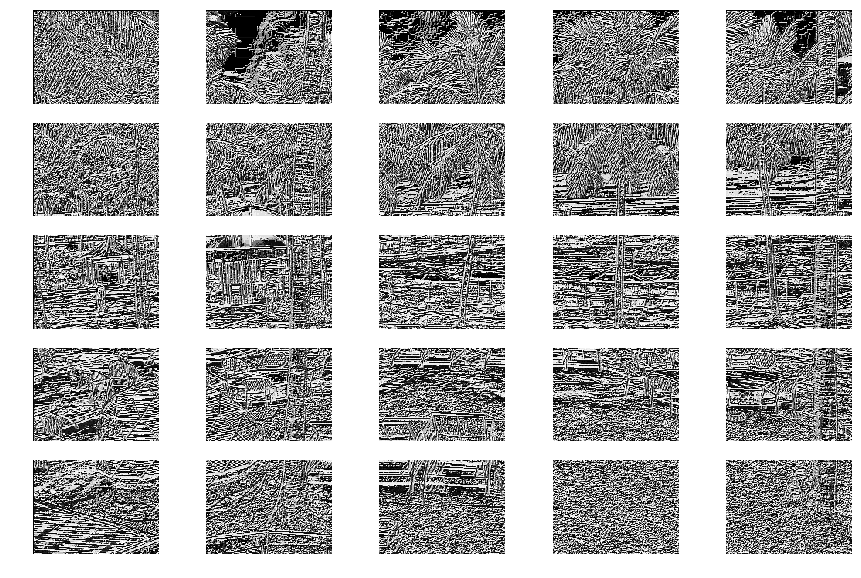

In [10]:
#plot patches
plt.figure(figsize=(15,10))
for i, window in enumerate(windows):
    plt.subplot(bins, bins, i+1)
    plt.axis('off')
    plt.imshow(window, cmap='gray')
plt.show()

We may get BLP codes for each patch.

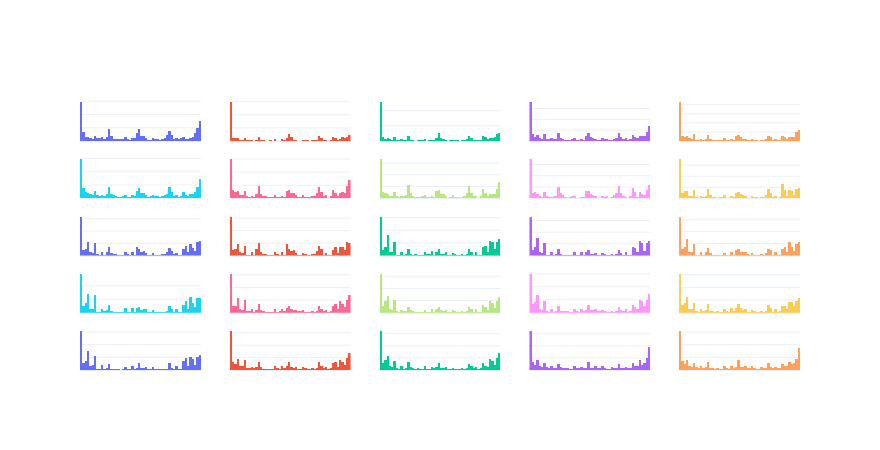

In [11]:
fig = make_subplots(rows=bins, cols=bins, start_cell="top-left")

for i, window in enumerate(windows):
    row, col=i//bins+1, i%bins+1
    fig.add_trace(go.Histogram(x=window.ravel(), histnorm='probability'), row, col)    
    fig.update_xaxes(showticklabels=False)
    fig.update_yaxes(showticklabels=False)
    
fig.update_layout(template="plotly_white",showlegend=False)
fig.show()

## prob c)
> Using the global descriptor you have created, implement a classification process 
to classify the images in the provided dataset into two categories: face images and non-face images.  
Comment the results. Hint: You can use simple histogram similarities.  
Is the global descriptor able/unable to represent whole images of different types, e.g. faces vs. cars?   
Identify problems (if any).  
Suggest solutions if possible.  

The dataset consists of a bunch of images of people’s faces taken from [MIT Faces Recognition Project database](https://courses.media.mit.edu/2004fall/mas622j/04.projects/faces/).

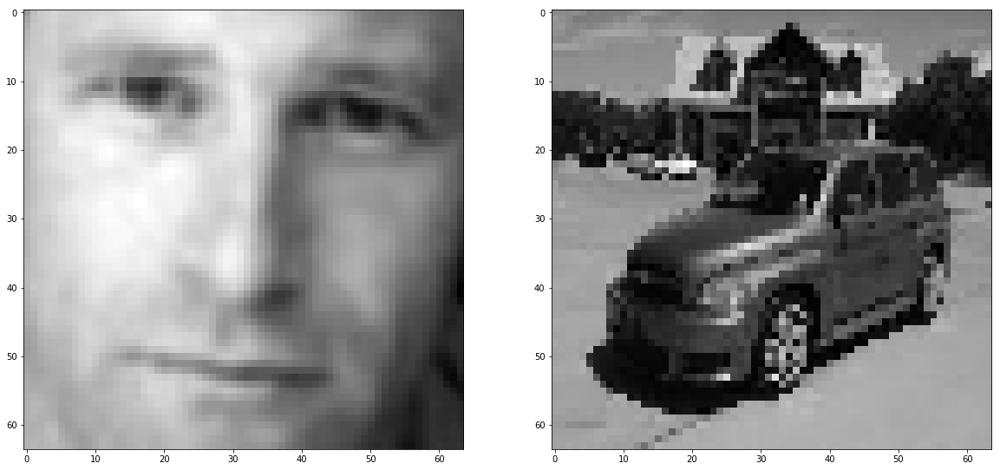

In [14]:
import glob
files = glob.glob('facedata/*.pgm')
people = [np.asarray(Image.open(file).convert('L')) for file in files]

files = glob.glob('cardata/*.jpg')
cars = [np.asarray(Image.open(file).convert('L').resize((64,64))) for file in files]

plot([people[0],cars[0]])

In [15]:
people_lbp = np.zeros((20,64,64))
cars_lbp = np.zeros((20,64,64))


for i in range(20):
    for x in range(1,63):
        for y in range(1,63):
            people_lbp[i,y,x] = lbp(people[i], x, y)
            cars_lbp[i,y,x] = lbp(cars[i], x, y)

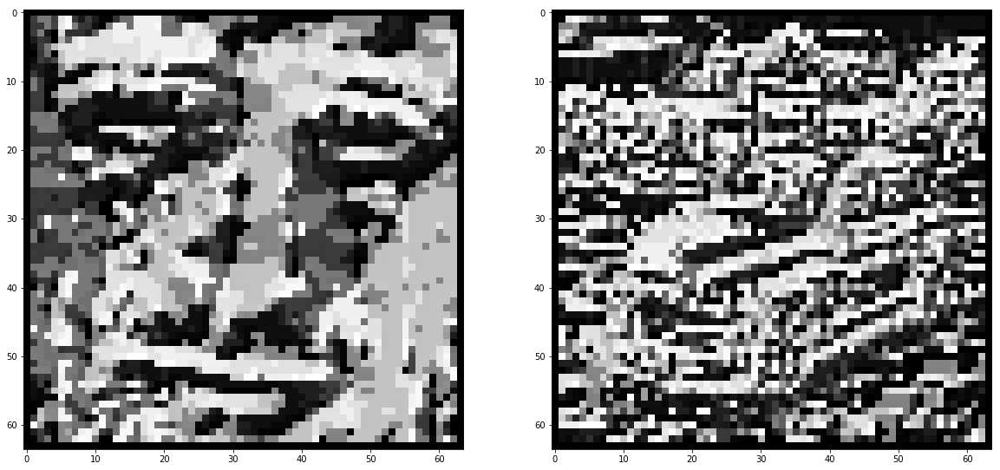

In [21]:
plot([people_lbp[0],cars_lbp[0]])

In [24]:
facehist=np.asarray([np.histogram(people_lbp[i,:,:], bins=255)[0] for i in range(20)])
carhist=np.asarray([np.histogram(cars_lbp[i,:,:], bins=255)[0] for i in range(20)])

In [42]:
faceavg = np.average(facehist, axis=0)
caravg = np.average(carhist, axis=0)
threshold = (faceavg+caravg)/2

print(threshold)

[6.73175e+02 4.78250e+01 2.38750e+01 2.83250e+01 3.07500e+01 6.27500e+00
 2.85250e+01 5.28000e+01 2.54750e+01 5.97500e+00 5.82500e+00 3.82500e+00
 2.90000e+01 6.05000e+00 7.34250e+01 1.12725e+02 4.85750e+01 9.20000e+00
 6.02500e+00 3.12500e+00 5.47500e+00 1.52500e+00 5.95000e+00 3.40000e+00
 3.02250e+01 3.70000e+00 4.17500e+00 3.05000e+00 5.20250e+01 3.12500e+00
 1.17425e+02 4.40250e+01 2.65750e+01 5.32500e+00 2.92500e+00 2.80000e+00
 4.37500e+00 1.12500e+00 3.32500e+00 3.62500e+00 4.37500e+00 9.75000e-01
 1.05000e+00 9.00000e-01 3.40000e+00 1.17500e+00 5.45000e+00 6.47500e+00
 3.26500e+01 3.32500e+00 2.92500e+00 2.27500e+00 4.65000e+00 8.25000e-01
 3.07500e+00 2.67500e+00 5.88500e+01 2.05000e+00 3.65000e+00 3.02500e+00
 8.57250e+01 2.90000e+00 4.26500e+01 1.88500e+01 3.43500e+01 5.75000e+00
 4.67500e+00 4.62500e+00 5.35000e+00 1.20000e+00 2.75000e+00 2.32500e+00
 4.37500e+00 1.02500e+00 8.25000e-01 8.50000e-01 2.77500e+00 1.07500e+00
 2.97500e+00 2.50000e+00 5.87500e+00 1.60000e+00 1.

In [108]:
facecorrect = 0
for i in range(20):
    if np.average(facehist[i]-threshold[i]) >= -20:
        facecorrect += 1
        
carcorrect = 0
for i in range(20):
    if np.average(carhist[i]-threshold[i]) < 12:
        carcorrect += 1

In [109]:
print(facecorrect, carcorrect)

14 18


## prob d) 
Decrease the window size and perform classification again. Comment the results.   

## prob e) 
Increase the window size and perform classification again. Comment the results.  

## prob f) 
Discuss how LBP can be used/modified for dynamic texture analysis, e.g. in a video.  